In [34]:
from PIL import Image
import glob, os
import numpy as np
import matplotlib.pyplot as plt
from skimage import  exposure, io
from tqdm import tqdm
import plotly.graph_objects as go
import plotly.express as px
import pandas as pd
import itertools
from collections import OrderedDict
import random

In [2]:
size = 216, 205

### Циклический сдвиг

In [3]:
def shift(lst, steps):
    if steps < 0:
        steps = abs(steps)
        for i in range(steps):
            lst.append(lst.pop(0))
    else:
        for i in range(steps):
            lst.insert(0, lst.pop())

### Смуф - функция

In [4]:
def smooth(y, box_pts):
    box = np.ones(box_pts) / box_pts
    y_smooth = np.convolve(y, box, mode='same')
    return y_smooth

### Считываем все названия папок

In [5]:
folders = [i for root, dirs, files in os.walk(".") for i in dirs[1:]]
folders[:2]

['Ар слабый диффузный склероз', 'Бе резко выраженный диффузный склероз']

### Считываем все изображения из папок

In [6]:
dictionary_folder = {}

for name_folder in folders:
    images_list = []
    for name_image in glob.glob(name_folder+"/*.bmp"):
        images_list.append(Image.open(name_image))
    dictionary_folder[name_folder]  = images_list

<ipython-input-7-5c5346cef9d0>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10, 8))


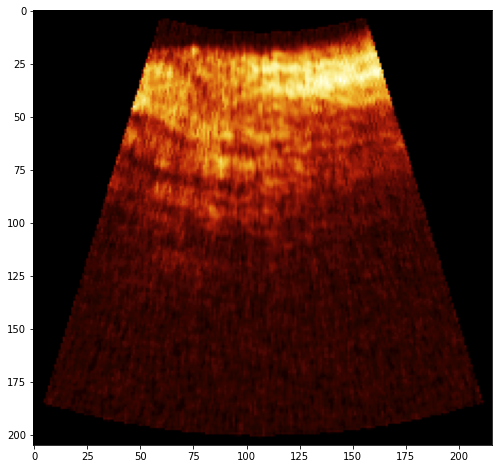

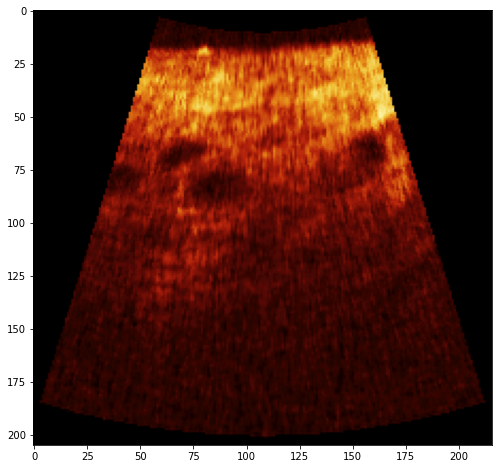

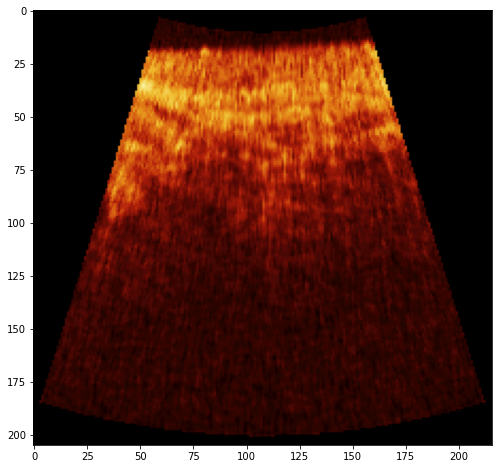

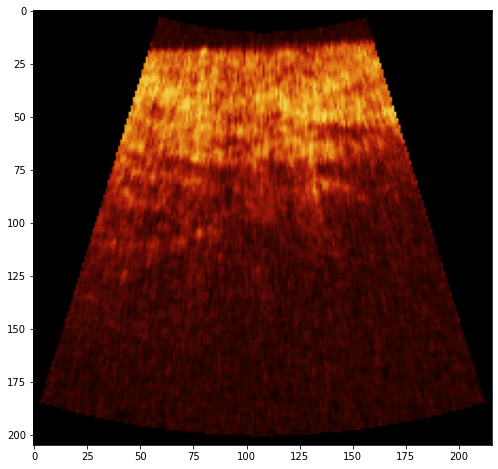

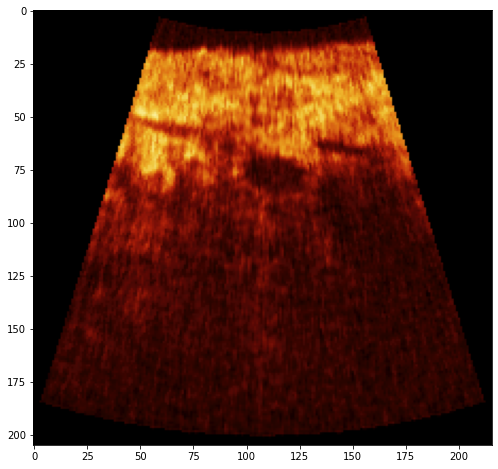

...

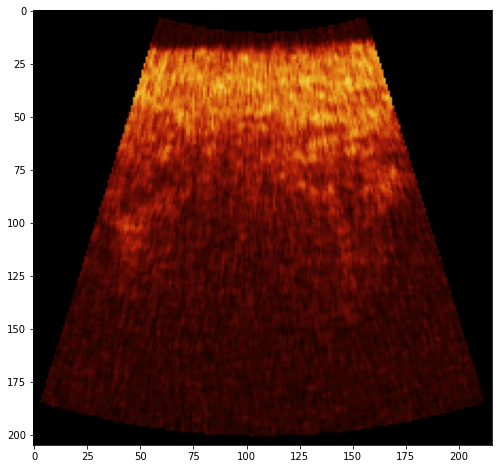

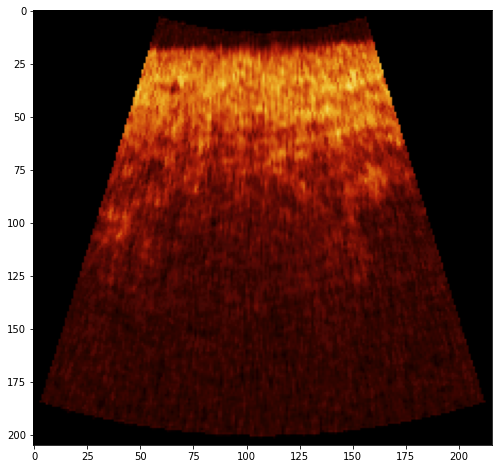

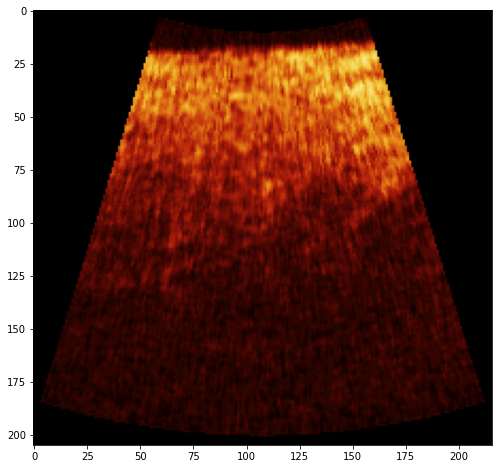

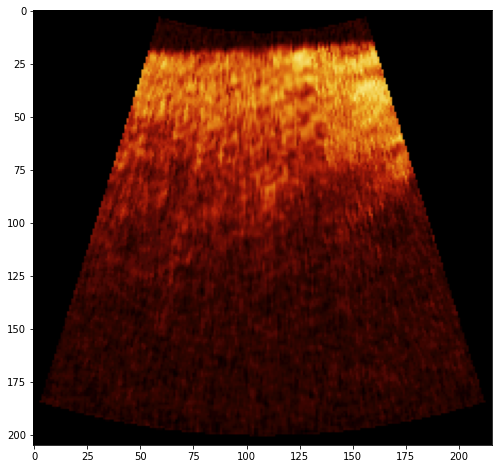

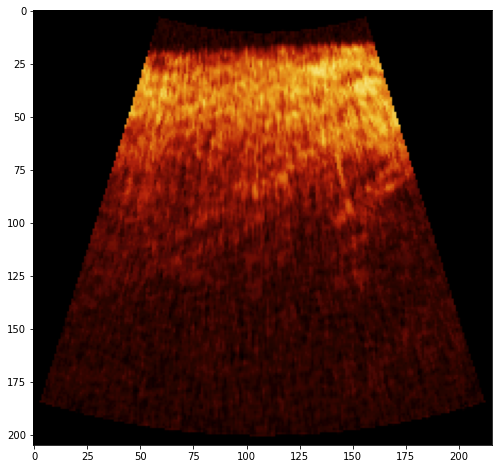

In [7]:
for key in dictionary_folder.keys():
    for i in range(0, len(dictionary_folder[key])):
        test = dictionary_folder[key][i]
        plt.figure(figsize=(10, 8))
        plt.imshow(test)

### Перевод в оттенки черно-белого и приведение к общему размеру

In [8]:
for key in dictionary_folder.keys():
    for i in range(0, len(dictionary_folder[key])):
        dictionary_folder[key][i] = dictionary_folder[key][i].convert('LA').resize(size)

In [9]:
test = dictionary_folder[folders[1]][1]

<ipython-input-10-5c5346cef9d0>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(10, 8))


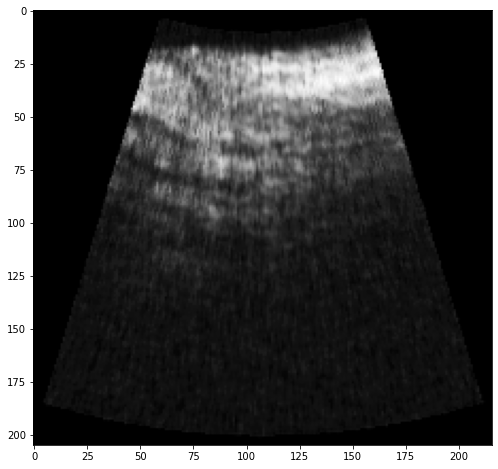

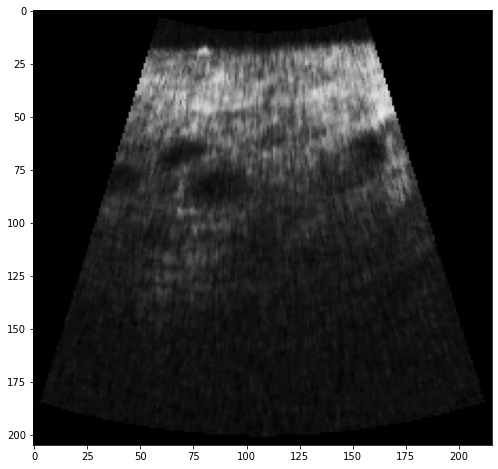

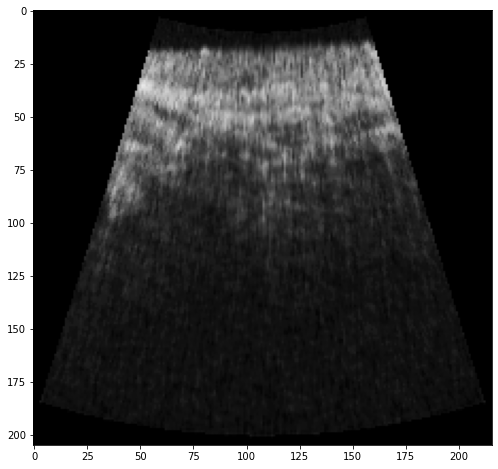

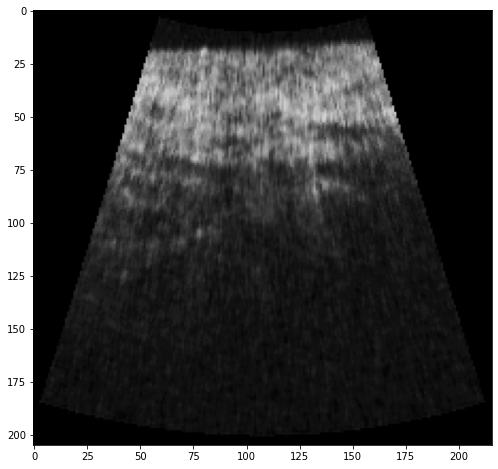

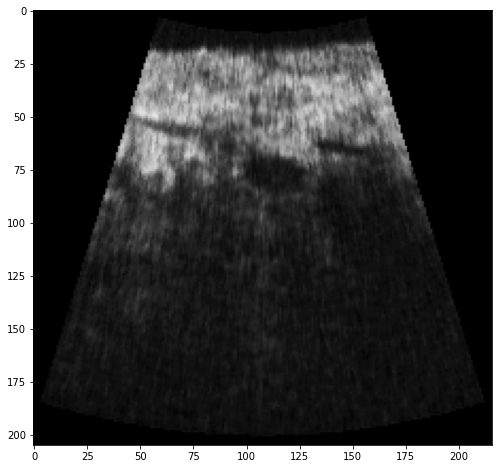

...

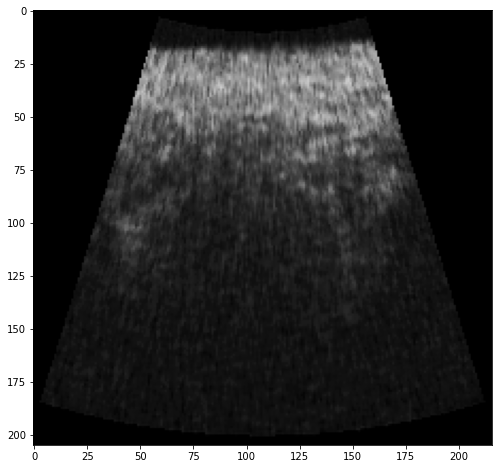

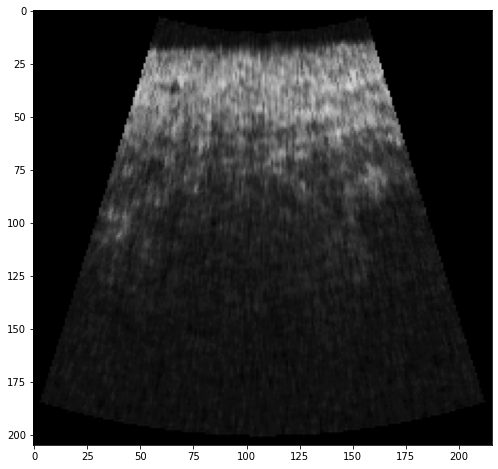

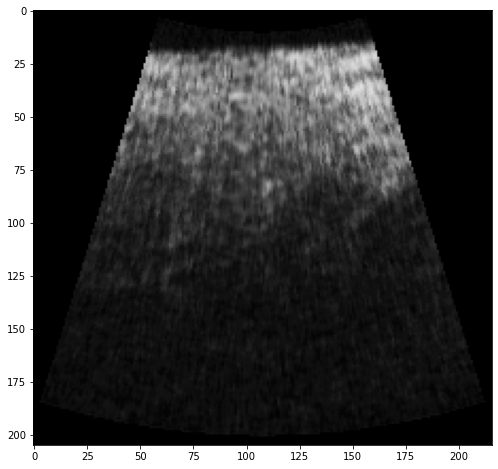

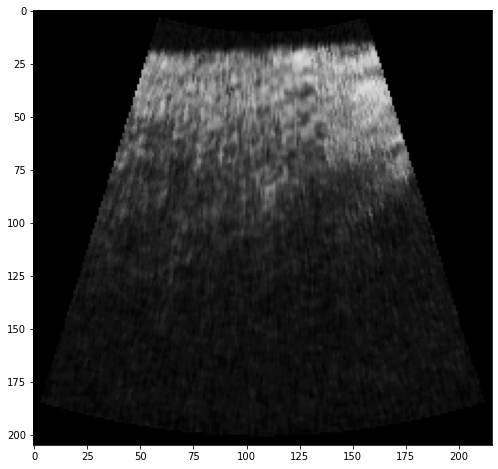

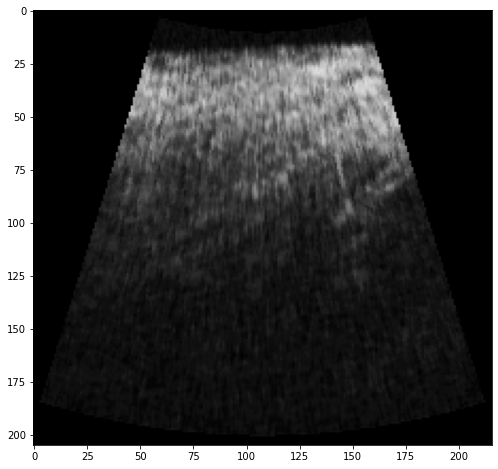

In [10]:
for key in dictionary_folder.keys():
    for i in range(0, len(dictionary_folder[key])):
        test = dictionary_folder[key][i]
        plt.figure(figsize=(10, 8))
        plt.imshow(test)

### Обрезаем черную полоску, чтобы убрать черный цвет и оставить шумы
### Будет понятно на графике как они есть

In [11]:
for key in dictionary_folder.keys():
    for iters in range(0, len(dictionary_folder[key])):
        image = dictionary_folder[key][iters]
        for i in range(0, size[1]-100):
            if image.getpixel((216//2, i+1))[0]-test.getpixel((216//2, i))[0]>0:
                index = i+1
                break
        arr = np.array(image)
        for i in range(0, size[0]):
            vector = arr[:, i, 0].tolist()
            shift(vector, -index)
            arr[:, i, 0] = vector
        dictionary_folder[key][iters] = Image.fromarray(arr)

In [211]:
test = dictionary_folder[folders[5]][0]

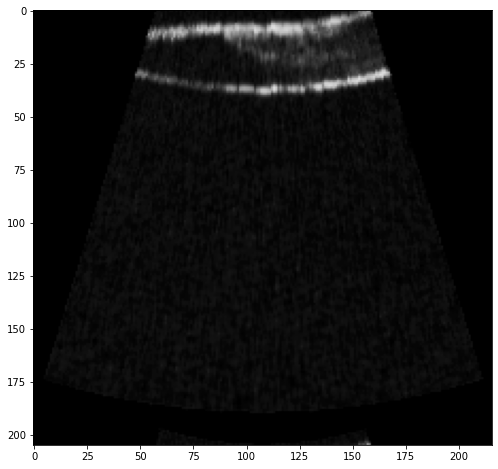

In [212]:
plt.figure(figsize=(10, 8))
plt.imshow(test)

### Собираем карты по скользящему среднему

In [12]:
dictionary_map_hist = {}
hight = 80
bins = 249
for key in tqdm(dictionary_folder.keys()):
    list_map_hist = []
    for iters in range(0, len(dictionary_folder[key])):
        image = dictionary_folder[key][iters]
        map_hist = np.zeros((hight, bins), dtype=np.float64)
        for i in range(0, hight):
            slice_image = image.crop((0, i, 216, i+5))
            map_hist[i] = smooth(np.histogram(slice_image, bins=256)[0][1:250], 15)
        list_map_hist.append(map_hist)
    dictionary_map_hist[key] = list_map_hist

100%|██████████████████████████████████████████████████████████████████████████████████| 15/15 [00:03<00:00,  4.10it/s]


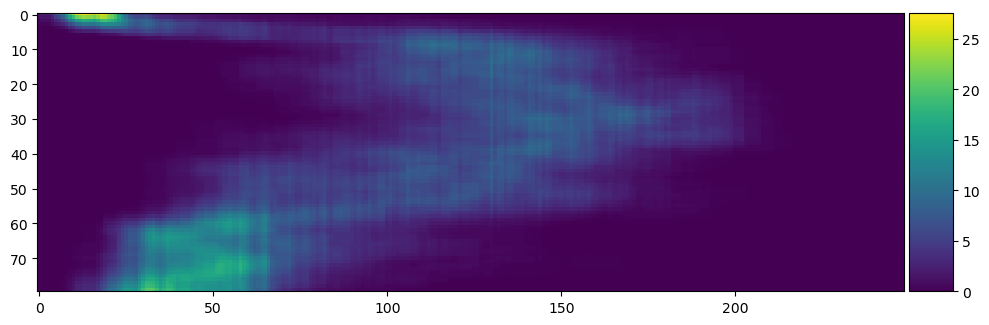

In [216]:
plt.figure(figsize=(10, 10), dpi=100)
io.imshow(dictionary_map_hist[folders[0]][3])
pass

### Считаем кривые центра масс

In [13]:
dictionary_curves = {}
for key in tqdm(dictionary_map_hist.keys()):
    list_curves = []
    for iters in range(0, len(dictionary_map_hist[key])):
        map_hist = dictionary_map_hist[key][iters]
        curve = []
        for i in range(map_hist.shape[0]):
            m = 0 
            M = 0
            for j in range(map_hist.shape[1]):
                M += map_hist[i][j]*j
                m += map_hist[i][j]
            curve.append(M/m)
        list_curves.append(curve)
    dictionary_curves[key] =  list_curves       

100%|██████████████████████████████████████████████████████████████████████████████████| 15/15 [00:06<00:00,  2.44it/s]


### Запишем данные

In [219]:
data = pd.DataFrame(columns=range(0, hight))
label = []
for key in tqdm(dictionary_curves.keys()):
    label.append([key]*len(dictionary_curves[key]))
    for iters in range(0, len(dictionary_curves[key])):
        temp = {i:j for i, j in zip(range(0, hight), dictionary_curves[key][iters])}
        data = data.append(temp, ignore_index=True)
data["label"] = list(itertools.chain(*label))


100%|██████████████████████████████████████████████████████████████████████████████████| 15/15 [00:00<00:00, 67.88it/s]


In [220]:
data.to_excel("mass_curves.xlsx")

In [38]:
traces = []

figure = go.Figure()
number_of_colors = len(dictionary_curves)

colors = ["#"+''.join([random.choice('0123456789ABCDEF') for j in range(6)])
             for i in range(number_of_colors)]
for key, color in zip(dictionary_curves.keys(), colors):
    count = 0
    for iters in range(0, len(dictionary_curves[key])):
        if count==0:
            figure.add_trace(go.Scatter(x=np.arange(0, hight), y=np.array(dictionary_curves[key][iters]),
                                    name=key, legendgroup=key, line=dict(color=color)))
        else:
            figure.add_trace(go.Scatter(x=np.arange(0, hight), y=np.array(dictionary_curves[key][iters]),
                                    legendgroup=key, showlegend=False, line=dict(color=color)))
        count += 1
        
figure.show()

In [33]:
color = list(np.random.choice(range(256), size=5))
color

[219, 216, 114, 113, 177]